<a href="https://colab.research.google.com/github/varJATIN/Amazon-Food-Reviews-Summarization/blob/master/DCGAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


In [5]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [0]:
!unzip -q "/content/drive/My Drive/Copy of img_align_celeba.zip"


In [25]:
pwd

'/content'

In [10]:
ls


drive/  img_align_folder/  sample_data/


In [11]:
cd img_align_folder/

/content/img_align_folder


In [12]:
ls # it is working fine there are many jpg files

img_align_celeba/


In [0]:
dataroot="/content/img_align_folder"
workers=2
batch_size=128
image_size=64
nc=3
nz=100
num_epochs=100
ngf=64
ndf=64
lr=0.0002
ngpu=1
beta1=0.5

In [0]:
dataset=dset.ImageFolder(root=dataroot,transform=transforms.Compose([transforms.Resize(image_size),transforms.CenterCrop(image_size),transforms.ToTensor(),transforms.Normalize((0.5,0.5,0.5),(0.5,0.5,0.5))]))

In [0]:
#it forms a list of the 2 elements:-batches and corresponding labels with 0 values when iterated
# and 1st element of the list is the list of lists in batch*channels*img_size*img_size
dataloader=torch.utils.data.DataLoader(dataset,batch_size=batch_size,shuffle=True,num_workers=workers)

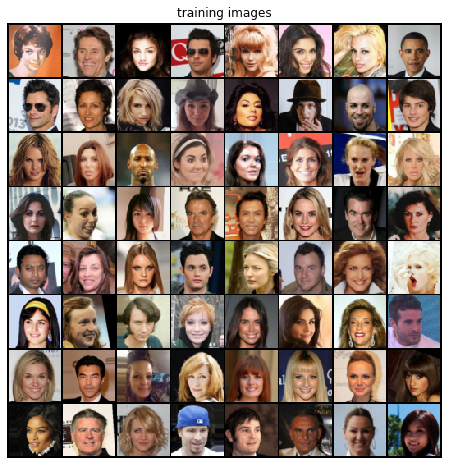

In [11]:
device=torch.device("cuda:0" if(torch.cuda.is_available() and ngpu>0) else "cpu")
real_batch=next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("training images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64],padding=2,normalize=True).cpu(),(1,2,0)))


In [0]:
def weights_init(m):
  classname=m.__class__.__name__
  if classname.find('Conv')!=-1:
    nn.init.normal_(m.weight.data,0.0,0.02)
  elif classname.find('BatchNorm')!=-1:
    nn.init.normal_(m.weight.data,1.0,0.02)
    nn.init.constant_(m.bias.data,0)

In [0]:
class Generator(nn.Module):
  def __init__(self,ngpu):
    super(Generator,self).__init__()
    self.ngpu=ngpu
    self.main=nn.Sequential(
        nn.ConvTranspose2d(nz,ngf*8,4,1,0,bias=False),
        nn.BatchNorm2d(ngf*8),
        nn.ReLU(True),
        nn.ConvTranspose2d(ngf*8,ngf*4,4,2,1,bias=False),
        nn.BatchNorm2d(ngf*4),
        nn.ReLU(True),
        nn.ConvTranspose2d(ngf*4,ngf*2,4,2,1,bias=False),
        nn.BatchNorm2d(ngf*2),
        nn.ReLU(True),
        nn.ConvTranspose2d(ngf*2,ngf,4,2,1,bias=False),
        nn.BatchNorm2d(ngf),
        nn.ReLU(True),
        nn.ConvTranspose2d(ngf,nc,4,2,1,bias=False),
        nn.Tanh()
    )
  def forward(self,input):
    return self.main(input)


In [14]:
netG=Generator(ngpu).to(device)

netG.apply(weights_init)

print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [0]:
class Discriminator(nn.Module):
  def __init__(self,ngpu):
    super(Discriminator,self).__init__()
    self.ngpu=ngpu
    self.main=nn.Sequential(
        nn.Conv2d(nc,ndf,4,2,1,bias=False),
        nn.LeakyReLU(0.2,inplace=True),
        #
        nn.Conv2d(ndf,ndf*2,4,2,1,bias=False),
        nn.BatchNorm2d(ndf*2),
        nn.LeakyReLU(0.2,inplace=True),
        #
        nn.Conv2d(ndf*2,ndf*4,4,2,1,bias=False),
        nn.BatchNorm2d(ndf*4),
        nn.LeakyReLU(0.2,inplace=True),
        #
        nn.Conv2d(ndf*4,ndf*8,4,2,1,bias=False),
        nn.BatchNorm2d(ndf*8),
        nn.LeakyReLU(0.2,inplace=True),
        nn.Conv2d(ndf*8,1,4,1,0,bias=False),
        nn.Sigmoid()
    )
  def forward(self,input):
    return self.main(input)

In [16]:
netD=Discriminator(ngpu).to(device)
netD.apply(weights_init)
print(netD)




Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [0]:
criterion=nn.BCELoss()
fixed_noise=torch.randn(64,nz,1,1,device=device)
real_label=1
fake_label=0
optimizerD=optim.Adam(netD.parameters(),lr=lr,betas=(beta1,.999))
optimizerG=optim.Adam(netG.parameters(),lr=lr,betas=(beta1,.999))

In [18]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device) # we are passing 0 indices to extract the data not labels 
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/100][0/1583]	Loss_D: 1.6062	Loss_G: 5.5132	D(x): 0.5767	D(G(z)): 0.5501 / 0.0067
[0/100][50/1583]	Loss_D: 0.0047	Loss_G: 33.9288	D(x): 0.9959	D(G(z)): 0.0000 / 0.0000
[0/100][100/1583]	Loss_D: 0.6171	Loss_G: 9.6878	D(x): 0.9619	D(G(z)): 0.3200 / 0.0002
[0/100][150/1583]	Loss_D: 1.3460	Loss_G: 9.1568	D(x): 0.8220	D(G(z)): 0.5534 / 0.0061
[0/100][200/1583]	Loss_D: 1.1426	Loss_G: 7.3654	D(x): 0.9423	D(G(z)): 0.5440 / 0.0026
[0/100][250/1583]	Loss_D: 1.0427	Loss_G: 9.0331	D(x): 0.9617	D(G(z)): 0.5515 / 0.0011
[0/100][300/1583]	Loss_D: 0.7723	Loss_G: 3.3507	D(x): 0.7182	D(G(z)): 0.2193 / 0.0610
[0/100][350/1583]	Loss_D: 1.7188	Loss_G: 0.3872	D(x): 0.3091	D(G(z)): 0.0150 / 0.7260
[0/100][400/1583]	Loss_D: 0.5515	Loss_G: 5.6917	D(x): 0.8730	D(G(z)): 0.2786 / 0.0069
[0/100][450/1583]	Loss_D: 0.3714	Loss_G: 4.3239	D(x): 0.8424	D(G(z)): 0.1297 / 0.0235
[0/100][500/1583]	Loss_D: 0.7136	Loss_G: 6.8484	D(x): 0.9524	D(G(z)): 0.4183 / 0.0033
[0/100][550/1583]	Loss_D: 1.84

KeyboardInterrupt: ignored

In [0]:
count=0
for i, data in enumerate(dataloader, 0):
  count+=1
  print(data[0])

In [0]:
count

In [0]:
listo=[[1,3],[2,5]]
listo[0:]

In [0]:
b=real_batch
print(b)

In [0]:
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 2**128

Animation size has reached 21451957 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


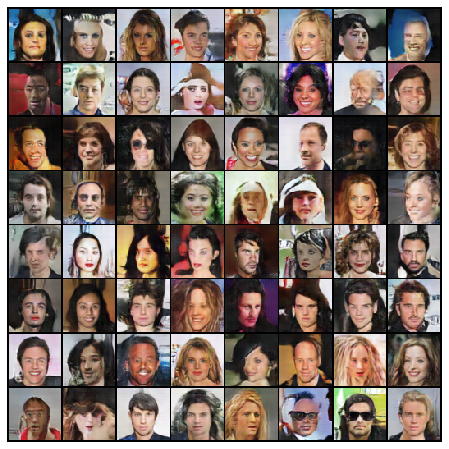

In [19]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())